### **이미지 및 재배환경데이터 기반 생육단계 분류 모델**
- 실험1. 식물종분류X + 이미지 기반 생육단계 분류
- 실험2. 식물종분류X + 이미지 & 재배환경 데이터 기반 생육단계 분류

### **작물별 이미지 디렉토리 생성 후 이미지 파일 옮기기**

In [ ]:
root_dir = '/mnt/aix7206/data/100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터'

folder_name = ['겨자채', '근대', '상추', '케일']

def get_target_dir(folder_name):
    return os.path.join(root_dir, folder_name)

for folder in folder_name:
    target_dir = get_target_dir(folder)
    if not os.path.exists(target_dir):
        os.makedirs(target_dir)
        print(f"디렉토리 생성됨: {target_dir}")

for root, dirs, files in os.walk(root_dir):
    for dir_name in dirs:
        for folder in folder_name:
            if folder in dir_name:
                current_dir = os.path.join(root, dir_name)
                target_dir = get_target_dir(folder)
                
                for file_name in os.listdir(current_dir):
                    file_path = os.path.join(current_dir, file_name)
                    if os.path.isfile(file_path):
                        try:
                            shutil.move(file_path, target_dir)
                            print(f"파일 이동: {file_path} > {target_dir}")
                        except Exception as e:
                            print(f"파일 이동 오류: {file_path}, 에러: {e}")

디렉토리 생성됨: /mnt/aix7206/data/100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터/겨자채
디렉토리 생성됨: /mnt/aix7206/data/100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터/근대
디렉토리 생성됨: /mnt/aix7206/data/100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터/상추
디렉토리 생성됨: /mnt/aix7206/data/100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터/케일
파일 이동: /mnt/aix7206/data/100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터/TS_3.상추13/C11_L01_01_003_199383.jpg > /mnt/aix7206/data/100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터/상추
파일 이동: /mnt/aix7206/data/100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터/TS_3.상추13/C11_L01_01_001_204058.jpg > /mnt/aix7206/data/100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터/상추
파일 이동: /mnt/aix7206/data/100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터/TS_3.상추13/C11_L01_01_002_392338.jpg > /mnt/aix7206/data/100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터/상추
파일 이동: /mnt/aix7206/data/100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터/TS_3.상추13/C11_L01_01_003_197843.jpg > /mnt/aix7206/data/100

### **작물별 이미지 개수 확인**

In [1]:
import os

def count_files_in_directory(root_dir):
    file_count = 0
    # 모든 하위 디렉토리와 파일을 순회
    for subdir, _, files in os.walk(root_dir):
        file_count += len(files)  # 현재 디렉토리의 파일 개수를 더함
    return file_count

In [3]:
crops = ['겨자채', '근대', '상추', '케일']

root_dir = '/mnt/aix7206/data/100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터'

for crop in crops:
    dir = os.path.join(root_dir, crop)
    file_count = count_files_in_directory(dir)
    print(f"{crop} 이미지 개수: {file_count}개")

겨자채 이미지 개수: 794개
근대 이미지 개수: 615개
상추 이미지 개수: 944개
케일 이미지 개수: 773개


### **csv파일 내 이미지 정보 확인**

In [7]:
csv_path = '/mnt/aix7206/data/train_final.csv'

In [8]:
df = pd.read_csv(csv_path)

/mnt/aix7206/anaconda3/envs/eunenv/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3552: DtypeWarning: Columns (41) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [9]:
df.head()

,image_file_path,image_fname,image_date_captured,image_crops,image_leaf,image_plant_body,image_crops_id,image_fext,image_growth_stage,image_width,image_image_id,image_kind_type,image_create_date,image_farm_id,image_height,growth_fr_weight,growth_measured_date,growth_crops_id,growth_leaf_width,growth_stem_thick,growth_leaf_cnt,growth_stem_length,growth_leaf_length,etc_inform,etc_crops_id,etc_create_date,ann_area,ann_isCrowd,ann_category_id,ann_bbox,ann_segmentation,ann_id,ann_image_id,lic_name,lic_id,lic_url,cat_name,cat_supercategory,cat_id,growth_leaf_index,growth_spad,growth_petiole_length,env_farm_id,env_receive_date,env_id,env_ti_value,env_hi_value,env_ci_value,env_ir_value,env_tl_value,env_ei_value,env_pl_value,ann_bbox_new
0,/100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터,C02_L03_01_001_393345.jpg,2021-09-03 14:11:05,겨자채,1.0,1.0,C02_L03_01,jpg,정식기,913.0,393345.0,아시아곱슬,2021-10-19,AIF001,1059.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,85768.37,0,0,"[461.33, 551.29, 281.42, 304.77]","[461.33, 551.29, 742.75, 551.29, 742.75, 856.0...",0,393345,CCMediaService,1.0,NaN,주,none,0,NaN,NaN,NaN,AIF001,2021-09-03 14:10:59,0.0,22.0,52.0,387.0,114.0,21.6,0.11,4.0,"[461, 551, 742, 855]"
1,/100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터,C02_L03_01_001_393345.jpg,2021-09-03 14:11:05,겨자채,1.0,1.0,C02_L03_01,jpg,정식기,913.0,393345.0,아시아곱슬,2021-10-19,AIF001,1059.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,28347.76,0,1,"[581.61, 550.73, 161.71, 175.3]","[581.61, 550.73, 743.32, 550.73, 743.32, 726.0...",1,393345,CCMediaService,1.0,NaN,잎,none,1,NaN,NaN,NaN,AIF001,2021-09-03 14:06:57,1.0,22.0,52.0,360.0,49.0,21.4,0.11,4.0,"[581, 550, 742, 725]"
2,/100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터,C02_L03_01_001_393345.jpg,2021-09-03 14:11:05,겨자채,1.0,1.0,C02_L03_01,jpg,정식기,913.0,393345.0,아시아곱슬,2021-10-19,AIF001,1059.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7761.03,0,2,"[634.63, 704.15, 89.31, 86.9]","[634.63, 704.15, 723.94, 704.15, 723.94, 791.0...",2,393345,CCMediaService,1.0,NaN,잎,none,2,NaN,NaN,NaN,AIF001,2021-09-03 14:06:57,1.0,22.0,52.0,360.0,49.0,21.4,0.11,4.0,"[634, 704, 723, 790]"
3,/100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터,C02_L03_01_001_393345.jpg,2021-09-03 14:11:05,겨자채,1.0,1.0,C02_L03_01,jpg,정식기,913.0,393345.0,아시아곱슬,2021-10-19,AIF001,1059.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12406.74,0,3,"[499.52, 759.47, 129.21, 96.02]","[499.52, 759.47, 628.73, 759.47, 628.73, 855.4...",3,393345,CCMediaService,1.0,NaN,잎,none,3,NaN,NaN,NaN,AIF001,2021-09-03 14:06:57,1.0,22.0,52.0,360.0,49.0,21.4,0.11,4.0,"[499, 759, 628, 855]"
4,/100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터,C02_L03_01_001_393345.jpg,2021-09-03 14:11:05,겨자채,1.0,1.0,C02_L03_01,jpg,정식기,913.0,393345.0,아시아곱슬,2021-10-19,AIF001,1059.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13972.27,0,4,"[461.33, 696.73, 169.69, 82.34]","[461.33, 696.73, 631.02, 696.73, 631.02, 779.0...",4,393345,CCMediaService,1.0,NaN,잎,none,4,NaN,NaN,NaN,AIF001,2021-09-03 14:06:57,1.0,22.0,52.0,360.0,49.0,21.4,0.11,4.0,"[461, 696, 630, 778]"


In [10]:
df.groupby(['image_crops'])['image_fname'].nunique()

image_crops
겨자채    794
근대     615
상추     944
케일     773
Name: image_fname, dtype: int64

In [11]:
# 중복된 행 개수 확인
len(df[df.duplicated()])

511597

In [12]:
# 중복 제거
df_ndup = df.drop_duplicates()
df_ndup.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30203 entries, 0 to 435947
Data columns (total 53 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   image_file_path        30203 non-null  object 
 1   image_fname            30203 non-null  object 
 2   image_date_captured    30203 non-null  object 
 3   image_crops            30203 non-null  object 
 4   image_leaf             30203 non-null  float64
 5   image_plant_body       30203 non-null  float64
 6   image_crops_id         30203 non-null  object 
 7   image_fext             30203 non-null  object 
 8   image_growth_stage     30203 non-null  object 
 9   image_width            30203 non-null  float64
 10  image_image_id         30203 non-null  float64
 11  image_kind_type        30203 non-null  object 
 12  image_create_date      30203 non-null  object 
 13  image_farm_id          30203 non-null  object 
 14  image_height           30203 non-null  float64
 15  g

In [15]:
df_ndup.groupby(['image_crops'])['image_fname'].nunique()

image_crops
겨자채    794
근대     615
상추     944
케일     773
Name: image_fname, dtype: int64

### **일단 있는 이미지로 모델 돌려보기**

In [2]:
import os
import numpy as np
import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)


import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, Input, concatenate
from sklearn.model_selection import train_test_split
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import matplotlib.pyplot as plt

2024-09-25 00:57:17.951525: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-09-25 00:57:17.951659: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-09-25 00:57:18.142205: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-09-25 00:57:18.536360: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-09-25 00:57:20.895028: W tensorflow/compiler/tf2

GPU 확인 및 지정

In [3]:
from tensorflow.python.client import device_lib

device_lib.list_local_devices()

2024-09-25 00:57:26.273128: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1929] Created device /device:GPU:0 with 46679 MB memory:  -> device: 0, name: NVIDIA RTX 6000 Ada Generation, pci bus id: 0000:01:00.0, compute capability: 8.9
2024-09-25 00:57:26.274199: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1929] Created device /device:GPU:1 with 46679 MB memory:  -> device: 1, name: NVIDIA RTX 6000 Ada Generation, pci bus id: 0000:23:00.0, compute capability: 8.9
2024-09-25 00:57:26.274995: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1929] Created device /device:GPU:2 with 46679 MB memory:  -> device: 2, name: NVIDIA RTX 6000 Ada Generation, pci bus id: 0000:41:00.0, compute capability: 8.9
2024-09-25 00:57:26.275766: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1929] Created device /device:GPU:3 with 46679 MB memory:  -> device: 3, name: NVIDIA RTX 6000 Ada Generation, pci bus id: 0000:61:00.0, compute capability: 8.9
2024-09-25 00:57:26.276545: I tensorflow/cor

[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 4184246898609827647
 xla_global_id: -1,
 name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 48946806784
 locality {
   bus_id: 1
   links {
     link {
       device_id: 1
       type: "StreamExecutor"
       strength: 1
     }
     link {
       device_id: 2
       type: "StreamExecutor"
       strength: 1
     }
     link {
       device_id: 3
       type: "StreamExecutor"
       strength: 1
     }
     link {
       device_id: 4
       type: "StreamExecutor"
       strength: 1
     }
     link {
       device_id: 5
       type: "StreamExecutor"
       strength: 1
     }
     link {
       device_id: 6
       type: "StreamExecutor"
       strength: 1
     }
     link {
       device_id: 7
       type: "StreamExecutor"
       strength: 1
     }
   }
 }
 incarnation: 2346365734440628303
 physical_device_desc: "device: 0, name: NVIDIA RTX 6000 Ada Generation, pci bus id: 0000:01:00.0, 

In [13]:
os.environ["CUDA_VISIBLE_DEVICES"] = "4, 5, 6, 7" # GPU 4~7번 사용

데이터 전처리

In [4]:
df = pd.read_csv('/mnt/aix7206/data/train_final.csv')
df_ndup = df.drop_duplicates()
df_ndup.head()

/tmp/ipykernel_1005204/3408310331.py:1: DtypeWarning: Columns (41) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('/mnt/aix7206/data/train_final.csv')


,image_file_path,image_fname,image_date_captured,image_crops,image_leaf,image_plant_body,image_crops_id,image_fext,image_growth_stage,image_width,image_image_id,image_kind_type,image_create_date,image_farm_id,image_height,growth_fr_weight,growth_measured_date,growth_crops_id,growth_leaf_width,growth_stem_thick,growth_leaf_cnt,growth_stem_length,growth_leaf_length,etc_inform,etc_crops_id,etc_create_date,ann_area,ann_isCrowd,ann_category_id,ann_bbox,ann_segmentation,ann_id,ann_image_id,lic_name,lic_id,lic_url,cat_name,cat_supercategory,cat_id,growth_leaf_index,growth_spad,growth_petiole_length,env_farm_id,env_receive_date,env_id,env_ti_value,env_hi_value,env_ci_value,env_ir_value,env_tl_value,env_ei_value,env_pl_value,ann_bbox_new
0,/100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터,C02_L03_01_001_393345.jpg,2021-09-03 14:11:05,겨자채,1.0,1.0,C02_L03_01,jpg,정식기,913.0,393345.0,아시아곱슬,2021-10-19,AIF001,1059.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,85768.37,0,0,"[461.33, 551.29, 281.42, 304.77]","[461.33, 551.29, 742.75, 551.29, 742.75, 856.0...",0,393345,CCMediaService,1.0,NaN,주,none,0,NaN,NaN,NaN,AIF001,2021-09-03 14:10:59,0.0,22.0,52.0,387.0,114.0,21.6,0.11,4.0,"[461, 551, 742, 855]"
1,/100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터,C02_L03_01_001_393345.jpg,2021-09-03 14:11:05,겨자채,1.0,1.0,C02_L03_01,jpg,정식기,913.0,393345.0,아시아곱슬,2021-10-19,AIF001,1059.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,28347.76,0,1,"[581.61, 550.73, 161.71, 175.3]","[581.61, 550.73, 743.32, 550.73, 743.32, 726.0...",1,393345,CCMediaService,1.0,NaN,잎,none,1,NaN,NaN,NaN,AIF001,2021-09-03 14:06:57,1.0,22.0,52.0,360.0,49.0,21.4,0.11,4.0,"[581, 550, 742, 725]"
2,/100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터,C02_L03_01_001_393345.jpg,2021-09-03 14:11:05,겨자채,1.0,1.0,C02_L03_01,jpg,정식기,913.0,393345.0,아시아곱슬,2021-10-19,AIF001,1059.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7761.03,0,2,"[634.63, 704.15, 89.31, 86.9]","[634.63, 704.15, 723.94, 704.15, 723.94, 791.0...",2,393345,CCMediaService,1.0,NaN,잎,none,2,NaN,NaN,NaN,AIF001,2021-09-03 14:06:57,1.0,22.0,52.0,360.0,49.0,21.4,0.11,4.0,"[634, 704, 723, 790]"
3,/100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터,C02_L03_01_001_393345.jpg,2021-09-03 14:11:05,겨자채,1.0,1.0,C02_L03_01,jpg,정식기,913.0,393345.0,아시아곱슬,2021-10-19,AIF001,1059.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12406.74,0,3,"[499.52, 759.47, 129.21, 96.02]","[499.52, 759.47, 628.73, 759.47, 628.73, 855.4...",3,393345,CCMediaService,1.0,NaN,잎,none,3,NaN,NaN,NaN,AIF001,2021-09-03 14:06:57,1.0,22.0,52.0,360.0,49.0,21.4,0.11,4.0,"[499, 759, 628, 855]"
4,/100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터,C02_L03_01_001_393345.jpg,2021-09-03 14:11:05,겨자채,1.0,1.0,C02_L03_01,jpg,정식기,913.0,393345.0,아시아곱슬,2021-10-19,AIF001,1059.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13972.27,0,4,"[461.33, 696.73, 169.69, 82.34]","[461.33, 696.73, 631.02, 696.73, 631.02, 779.0...",4,393345,CCMediaService,1.0,NaN,잎,none,4,NaN,NaN,NaN,AIF001,2021-09-03 14:06:57,1.0,22.0,52.0,360.0,49.0,21.4,0.11,4.0,"[461, 696, 630, 778]"


In [5]:
len(df_ndup)

30203

In [6]:
df_ndup['image_growth_stage'].value_counts()

image_growth_stage
생육기    23422
정식기     5589
수확기     1192
Name: count, dtype: int64

In [9]:
df_ndup.groupby(['image_growth_stage'])['image_fname'].nunique()

image_growth_stage
생육기    2407
수확기     197
정식기     522
Name: image_fname, dtype: int64

In [4]:
root_dir = '/mnt/aix7206/data/'
image_dir = '/mnt/aix7206/data/100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터/겨자채'

def create_full_path(row):
    full_path = os.path.join(root_dir, str(row['image_file_path']), str(row['image_crops']), str(row['image_fname']))
    return full_path

# 이미지 파일 경로와 생육단계 레이블을 CSV 파일에서 불러오기
df_ndup['image_file_path'] = df_ndup['image_file_path'].apply(lambda x: x[1:]) # image_file_path를 root로 보는 성질이 존재
df_ndup['full_image_path'] = df_ndup.apply(create_full_path, axis=1)
df_ndup.head()

/tmp/ipykernel_613730/3646794136.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_ndup['image_file_path'] = df_ndup['image_file_path'].apply(lambda x: x[1:]) # image_file_path를 root로 보는 성질이 존재
/tmp/ipykernel_613730/3646794136.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_ndup['full_image_path'] = df_ndup.apply(create_full_path, axis=1)


,image_file_path,image_fname,image_date_captured,image_crops,image_leaf,image_plant_body,image_crops_id,image_fext,image_growth_stage,image_width,image_image_id,image_kind_type,image_create_date,image_farm_id,image_height,growth_fr_weight,growth_measured_date,growth_crops_id,growth_leaf_width,growth_stem_thick,growth_leaf_cnt,growth_stem_length,growth_leaf_length,etc_inform,etc_crops_id,etc_create_date,ann_area,ann_isCrowd,ann_category_id,ann_bbox,ann_segmentation,ann_id,ann_image_id,lic_name,lic_id,lic_url,cat_name,cat_supercategory,cat_id,growth_leaf_index,growth_spad,growth_petiole_length,env_farm_id,env_receive_date,env_id,env_ti_value,env_hi_value,env_ci_value,env_ir_value,env_tl_value,env_ei_value,env_pl_value,ann_bbox_new,full_image_path
0,100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터,C02_L03_01_001_393345.jpg,2021-09-03 14:11:05,겨자채,1.0,1.0,C02_L03_01,jpg,정식기,913.0,393345.0,아시아곱슬,2021-10-19,AIF001,1059.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,85768.37,0,0,"[461.33, 551.29, 281.42, 304.77]","[461.33, 551.29, 742.75, 551.29, 742.75, 856.0...",0,393345,CCMediaService,1.0,NaN,주,none,0,NaN,NaN,NaN,AIF001,2021-09-03 14:10:59,0.0,22.0,52.0,387.0,114.0,21.6,0.11,4.0,"[461, 551, 742, 855]",/mnt/aix7206/data/100.지능형 수직농장 통합 데이터(엽채류)/01....
1,100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터,C02_L03_01_001_393345.jpg,2021-09-03 14:11:05,겨자채,1.0,1.0,C02_L03_01,jpg,정식기,913.0,393345.0,아시아곱슬,2021-10-19,AIF001,1059.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,28347.76,0,1,"[581.61, 550.73, 161.71, 175.3]","[581.61, 550.73, 743.32, 550.73, 743.32, 726.0...",1,393345,CCMediaService,1.0,NaN,잎,none,1,NaN,NaN,NaN,AIF001,2021-09-03 14:06:57,1.0,22.0,52.0,360.0,49.0,21.4,0.11,4.0,"[581, 550, 742, 725]",/mnt/aix7206/data/100.지능형 수직농장 통합 데이터(엽채류)/01....
2,100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터,C02_L03_01_001_393345.jpg,2021-09-03 14:11:05,겨자채,1.0,1.0,C02_L03_01,jpg,정식기,913.0,393345.0,아시아곱슬,2021-10-19,AIF001,1059.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7761.03,0,2,"[634.63, 704.15, 89.31, 86.9]","[634.63, 704.15, 723.94, 704.15, 723.94, 791.0...",2,393345,CCMediaService,1.0,NaN,잎,none,2,NaN,NaN,NaN,AIF001,2021-09-03 14:06:57,1.0,22.0,52.0,360.0,49.0,21.4,0.11,4.0,"[634, 704, 723, 790]",/mnt/aix7206/data/100.지능형 수직농장 통합 데이터(엽채류)/01....
3,100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터,C02_L03_01_001_393345.jpg,2021-09-03 14:11:05,겨자채,1.0,1.0,C02_L03_01,jpg,정식기,913.0,393345.0,아시아곱슬,2021-10-19,AIF001,1059.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12406.74,0,3,"[499.52, 759.47, 129.21, 96.02]","[499.52, 759.47, 628.73, 759.47, 628.73, 855.4...",3,393345,CCMediaService,1.0,NaN,잎,none,3,NaN,NaN,NaN,AIF001,2021-09-03 14:06:57,1.0,22.0,52.0,360.0,49.0,21.4,0.11,4.0,"[499, 759, 628, 855]",/mnt/aix7206/data/100.지능형 수직농장 통합 데이터(엽채류)/01....
4,100.지능형 수직농장 통합 데이터(엽채류)/01.데이터/1.Training/원천데이터,C02_L03_01_001_393345.jpg,2021-09-03 14:11:05,겨자채,1.0,1.0,C02_L03_01,jpg,정식기,913.0,393345.0,아시아곱슬,2021-10-19,AIF001,1059.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13972.27,0,4,"[461.33, 696.73, 169.69, 82.34]","[461.33, 696.73, 631.02, 696.73, 631.02, 779.0...",4,393345,CCMediaService,1.0,NaN,잎,none,4,NaN,NaN,NaN,AIF001,2021-09-03 14:06:57,1.0,22.0,52.0,360.0,49.0,21.4,0.11,4.0,"[461, 696, 630, 778]",/mnt/aix7206/data/100.지능형 수직농장 통합 데이터(엽채류)/01....


In [5]:
# 생육단계를 숫자형으로 변환 (예: 정식기: 0, 생육기: 1, 수확기: 2)
label_map = {'정식기': 0, '생육기': 1, '수확기': 2}
df_ndup['label_growth_stage'] = df_ndup['image_growth_stage'].map(label_map)

/tmp/ipykernel_613730/200596996.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_ndup['label_growth_stage'] = df_ndup['image_growth_stage'].map(label_map)


모델 학습: CNN (only with images)

In [8]:
def load_images(df, img_size=(150, 150)):
    images = []
    labels = []
    for index, row in df.iterrows():
        img_path = row['full_image_path']
        label = row['label_growth_stage']
        try:
            img = load_img(img_path, target_size=img_size)
            img = img_to_array(img)
            images.append(img)
            labels.append(label)
        except Exception as e:
            print(f"Error loading image {img_path}: {e}")
    
    images = np.array(images, dtype='float32') / 255.0
    labels = np.array(labels)
    return images, labels

images, labels = load_images(df_ndup)

labels = to_categorical(labels, num_classes=3)

X_train, X_val, y_train, y_val = train_test_split(images, labels, test_size=0.2, random_state=42)

In [11]:
strategy = tf.distribute.MirroredStrategy(devices=["/gpu:4", "/gpu:5", "/gpu:6", "/gpu:7"])

with strategy.scope():
    model = Sequential([
        Conv2D(32, (3, 3), activation='relu', input_shape=(150, 150, 3)),
        MaxPooling2D(pool_size=(2, 2)),
        Conv2D(64, (3, 3), activation='relu'),
        MaxPooling2D(pool_size=(2, 2)),
        Conv2D(128, (3, 3), activation='relu'),
        MaxPooling2D(pool_size=(2, 2)),
        Flatten(),
        Dense(128, activation='relu'),
        Dropout(0.5),
        Dense(3, activation='softmax')
    ])

    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# 모델 학습
history = model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=20, batch_size=32)


INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:4', '/job:localhost/replica:0/task:0/device:GPU:5', '/job:localhost/replica:0/task:0/device:GPU:6', '/job:localhost/replica:0/task:0/device:GPU:7')


2024-09-21 15:59:38.837155: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1929] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 16496 MB memory:  -> device: 0, name: NVIDIA RTX 6000 Ada Generation, pci bus id: 0000:01:00.0, compute capability: 8.9
2024-09-21 15:59:38.837689: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1929] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 45390 MB memory:  -> device: 1, name: NVIDIA RTX 6000 Ada Generation, pci bus id: 0000:23:00.0, compute capability: 8.9
2024-09-21 15:59:38.838169: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1929] Created device /job:localhost/replica:0/task:0/device:GPU:2 with 45390 MB memory:  -> device: 2, name: NVIDIA RTX 6000 Ada Generation, pci bus id: 0000:41:00.0, compute capability: 8.9
2024-09-21 15:59:38.838642: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1929] Created device /job:localhost/replica:0/task:0/device:GPU:3 with 45390 MB memory:  -> device: 3, name: NV

Epoch 1/20
INFO:tensorflow:Collective all_reduce tensors: 10 all_reduces, num_devices = 4, group_size = 4, implementation = CommunicationImplementation.NCCL, num_packs = 1
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Collective all_reduce tensors: 10 all_reduces, num_devices = 4, group_size = 4, implementation = CommunicationImplementation.NCCL, num_packs = 1
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/r

2024-09-21 16:00:00.545541: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8902
2024-09-21 16:00:00.580026: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8902
2024-09-21 16:00:00.580170: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8902
2024-09-21 16:00:00.589974: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8902
2024-09-21 16:00:05.512708: I external/local_xla/xla/service/service.cc:168] XLA service 0x7f1432e38f50 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-09-21 16:00:05.512746: I external/local_xla/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA RTX 6000 Ada Generation, Compute Capability 8.9
2024-09-21 16:00:05.512751: I external/local_xla/xla/service/service.cc:176]   StreamExecutor device (1): NVIDIA RTX 6000 Ada Generation, Compute Capability 8.9
2024-09-21 16:00:0

756/756 [==============================] - ETA: 0s - loss: 0.1516 - accuracy: 0.9417INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).


2024-09-21 16:00:19.881407: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 1631070000 exceeds 10% of free system memory.
2024-09-21 16:00:20.386764: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 1631070000 exceeds 10% of free system memory.


756/756 [==============================] - 28s 23ms/step - loss: 0.1516 - accuracy: 0.9417 - val_loss: 0.0171 - val_accuracy: 0.9937
Epoch 2/20
756/756 [==============================] - 13s 17ms/step - loss: 0.0234 - accuracy: 0.9935 - val_loss: 0.0202 - val_accuracy: 0.9957
Epoch 3/20
756/756 [==============================] - 13s 18ms/step - loss: 0.0149 - accuracy: 0.9957 - val_loss: 0.0086 - val_accuracy: 0.9978
Epoch 4/20
756/756 [==============================] - 13s 18ms/step - loss: 0.0159 - accuracy: 0.9955 - val_loss: 0.0056 - val_accuracy: 0.9992
Epoch 5/20
756/756 [==============================] - 13s 17ms/step - loss: 0.0056 - accuracy: 0.9985 - val_loss: 0.0051 - val_accuracy: 0.9990
Epoch 6/20
756/756 [==============================] - 13s 17ms/step - loss: 0.0152 - accuracy: 0.9955 - val_loss: 0.0038 - val_accuracy: 0.9990
Epoch 7/20
756/756 [==============================] - 14s 18ms/step - loss: 0.0060 - accuracy: 0.9982 - val_loss: 0.0038 - val_accuracy: 0.9992
Epo

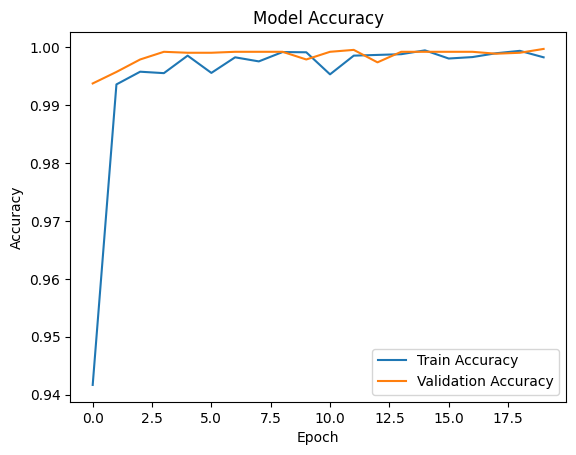

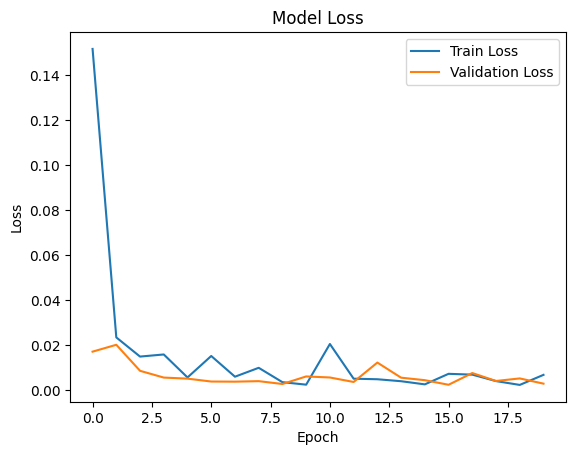

/mnt/aix7206/anaconda3/envs/eunenv/lib/python3.9/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [12]:
# 학습 결과 시각화
# 정확도 시각화
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()
plt.show()

# 손실 시각화
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()
plt.show()

# 모델 저장
model.save('growth_stage_classifier.h5')

모델 학습: CNN (images + env info)

In [9]:
# 이미지 파일 경로와 재배환경 데이터 분리
image_paths = df_ndup['full_image_path'].apply(lambda x: os.path.join(image_dir, x)).values
env_data = df_ndup[['env_ti_value', 'env_hi_value', 'env_ci_value', 'env_ir_value', 'env_tl_value', 'env_ei_value', 'env_pl_value']].values
labels = df_ndup['label_growth_stage'].values

In [10]:
def load_images(image_paths, img_size=(150, 150)):
    images = []
    for img_path in image_paths:
        try:
            img = load_img(img_path, target_size=img_size)
            img = img_to_array(img)
            images.append(img)
        except Exception as e:
            print(f"Error loading img {img_path}: {e}")
        
    images = np.array(images, dtype='float32') / 255.0 # 정규화
    return images

# 이미지 데이터 로드
images = load_images(image_paths)
# 라벨 one-hot encoding
labels = to_categorical(labels, num_classes=3)
# 학습용, 검증용 데이터 분리
X_train_img, X_val_img, X_train_env, X_val_env, y_train, y_val = train_test_split(images, env_data, labels, test_size=0.2, random_state=42)

In [14]:
strategy = tf.distribute.MirroredStrategy(devices=["/gpu:4", "/gpu:5", "/gpu:6", "/gpu:7"])

with strategy.scope():
    # CNN 모델 구성 (이미지 처리 부분)
    input_img = Input(shape=(150, 150, 3), name='image_input')
    x = Conv2D(32, (3, 3), activation='relu')(input_img)
    x = MaxPooling2D(pool_size=(2, 2))(x)
    x = Conv2D(64, (3, 3), activation='relu')(x)
    x = MaxPooling2D(pool_size=(2, 2))(x)
    x = Conv2D(128, (3, 3), activation='relu')(x)
    x = MaxPooling2D(pool_size=(2, 2))(x)
    x = Flatten()(x)

    # FCN 모델 구성 (재배환경 데이터 처리 부분)
    input_env = Input(shape=(7,), name='env_input')  # 7개의 재배환경 값
    y = Dense(64, activation='relu')(input_env)
    y = Dense(32, activation='relu')(y)

    # 이미지 특징과 재배환경 특징을 결합
    combined = concatenate([x, y])

    # 최종 분류기
    z = Dense(128, activation='relu')(combined)
    z = Dropout(0.5)(z)
    z = Dense(3, activation='softmax')(z)  # 생육단계는 3개의 클래스

    # 모델 구성
    model = Model(inputs=[input_img, input_env], outputs=z)

    # 모델 컴파일
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# 모델 학습
history = model.fit(
    {'image_input': X_train_img, 'env_input': X_train_env}, y_train,
    validation_data=({'image_input': X_val_img, 'env_input': X_val_env}, y_val),
    epochs=20,
    batch_size=32
)


INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:4', '/job:localhost/replica:0/task:0/device:GPU:5', '/job:localhost/replica:0/task:0/device:GPU:6', '/job:localhost/replica:0/task:0/device:GPU:7')


2024-09-22 07:22:22.635231: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 6523740000 exceeds 10% of free system memory.
2024-09-22 07:22:31.430834: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 6523740000 exceeds 10% of free system memory.


Epoch 1/20
INFO:tensorflow:Collective all_reduce tensors: 14 all_reduces, num_devices = 4, group_size = 4, implementation = CommunicationImplementation.NCCL, num_packs = 1
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Collective all_reduce tensors: 14 all_reduces, num_devices = 4, group_size = 4, implementation = CommunicationImplementation.NCCL, num_packs = 1
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/r

2024-09-22 07:22:59.725488: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8902
2024-09-22 07:22:59.736030: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8902
2024-09-22 07:22:59.737286: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8902
2024-09-22 07:22:59.756852: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8902
2024-09-22 07:23:06.589725: I external/local_xla/xla/service/service.cc:168] XLA service 0x7f83a36fa2d0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-09-22 07:23:06.589785: I external/local_xla/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA RTX 6000 Ada Generation, Compute Capability 8.9
2024-09-22 07:23:06.589792: I external/local_xla/xla/service/service.cc:176]   StreamExecutor device (1): NVIDIA RTX 6000 Ada Generation, Compute Capability 8.9
2024-09-22 07:23:0

756/756 [==============================] - ETA: 0s - loss: 0.2346 - accuracy: 0.9077INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
756/756 [==============================] - 54s 41ms/step - loss: 0.2346 - accuracy: 0.9077 - val_loss: 0.0329 - val_accuracy: 0.9844
Epoch 2/20
756/756 [==============================] - 22s 29ms/step - loss: 0.0406 - accuracy: 0.9873 - val_loss: 0.0248 - val_accuracy: 0.9924
Epoch 3/20
756/756 [==============================] - 23s 30ms/step - loss: 0.0255 - accuracy: 0.9922 - val_loss: 0.0082 - val_accuracy: 0.9980
Epoch 4/20
756/756 [==============================] - 23s 31ms/step - loss: 0.0175 - accuracy: 0.9951 - val_loss: 0.0062 - val_accuracy: 0.9987
Epoch 5/20
756/756 [==============================] - 23s 31ms/step - l

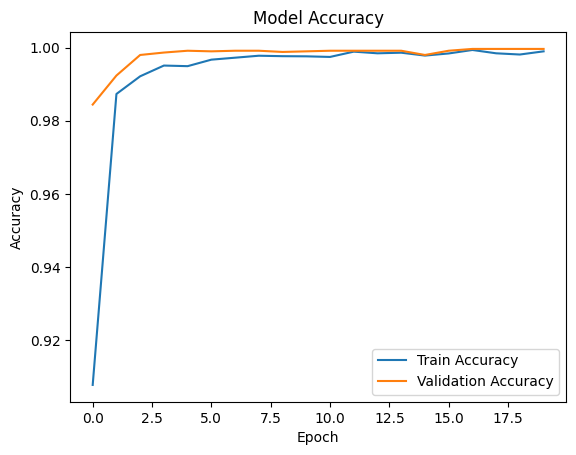

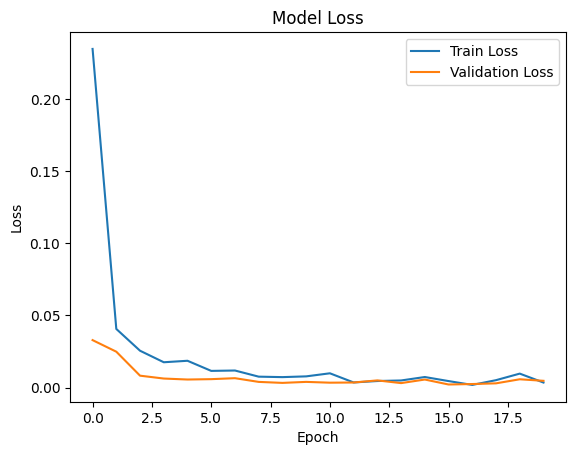

/mnt/aix7206/anaconda3/envs/eunenv/lib/python3.9/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [15]:
# 학습 결과 시각화
# 정확도 시각화
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()
plt.show()

# 손실 시각화
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()
plt.show()

# 모델 저장
model.save('growth_stage_classifier_combined.h5')

### ***2024.09.26 data updates***